# Lomin Project - 이미지 회전 각도 예측

## Prediction angle
---


## 목표

#### 이미지 회전 학습을 통해 target 이미지가 어느정도 회전해 있는지 각도를 예측

---

## 사용이미지

주어진 합성 이미지 활용



---


# 데이터 전처리

### 신규 이미지는 xml 을 다시 만들어 줘야 함

In [1]:
DATA_PATH = 'D:/coding/data_set/lomin/train_copy4'

# 이미지 크롭하고 회전시켜 저장하기

In [2]:
def rotation_crop(angle, path):
    # print(i.split('\\')[1].split('.')[0])
    src = cv2.imread(path, cv2.IMREAD_COLOR)
    height, width, channel = src.shape
    my_angle = angle

    ##                                  중심점(center), 각도(angle), 비율(scale)
    matrix = cv2.getRotationMatrix2D((width/2, height/2), -my_angle, 1)
    # 비율 : 가로길이 / 대각선

    #                                           흰색 : borderValue=(255, 255, 255)
    dst = cv2.warpAffine(src, matrix, (width, height), borderValue=(255, 255, 255))

    # 변경 이미지 저장 (파일명_각도)
    # cv2.imwrite(output_path + i.split('\\')[1].split('.')[0] + '_' + str(my_angle) + '.png', dst)
    cv2.imwrite(path, dst)

In [4]:
import os
import glob
import cv2
import random
import numpy as np

def lotation_img(img_count, input_path, output_path):
    # 폴더 만들기
    try :
        os.makedirs(output_path)
    except:
        pass

    img_list = sorted(glob.glob(input_path + '/*'))

    # 각도
    for j in range(0, 360):
        # 전체 이미지 중 랜덤하게 추출 == img_count
        random_list = np.random.choice(img_list, img_count, replace=False)
        
        for i in random_list:
            src = cv2.imread(i, cv2.IMREAD_COLOR)
            
            height, width, channel = src.shape
            
            ## 이미지 에서 500*500 이미지를 crop 함
            x_range = width - 501
            y_range = height - 501
            
            # 한장의 이미지에서 몇번 crop 할 것 인가?
            for k in range(0, 3):
                x1 = x_random = random.randint(0, x_range)
                y1 = y_random = random.randint(0, y_range)
                x2 = x1 + 500
                y2 = y1 + 500 
                # print(y1, y2, x1, x2)
                
                dst = src[y1:y2, x1:x2]


                total_path = output_path + i.split('\\')[-1].split('.')[0] + '('+str(k)+")_" + str(j) + '.png' 
                cv2.imwrite(total_path, dst)
                
                # 이미지 회전
                rotation_crop(j, total_path)
            


In [5]:
## train 
input_path = os.path.join(DATA_PATH, 'train/')
output_path = os.path.join(DATA_PATH, 'train_angle/')

## 전체 중 랜덤 추출 * 360 * 한장에 몇번 corp => 30 * 360 * 3 = 32400
lotation_img(30, input_path, output_path)

In [201]:
## test
input_path = os.path.join(DATA_PATH, 'test/')
output_path = os.path.join(DATA_PATH, 'test_angle/')

## 전체 중 랜덤 추출 * 360 * 한장에 몇번 corp => 3 * 360 * 3 = 3240
lotation_img(3, input_path, output_path)

---

# 모델 구성

In [8]:
import os
import gc
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# ## 드라이브 마운트

# from google.colab import drive
# drive.mount('/content/drive/')

### 파일 로드 및 확인

In [9]:
os.listdir(DATA_PATH)

['desktop.ini', 'test', 'test_angle', 'train', 'train_angle']

In [13]:
import pandas as pd

# train 데이터 프레임 만들기
df_train = pd.DataFrame(columns=['img_file', 'bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'class'])
df_test = pd.DataFrame(columns=['img_file', 'bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'class'])


In [11]:
## df_train - class 추가

import os
for i in os.listdir(os.path.join(DATA_PATH, 'train_angle/')):
    file_name = i
    x_min = 0
    y_min = 0
    x_max = 500
    y_max = 500
    object_label = i.split('_')[-1].split('.')[0]
    
    df_train = df_train.append(pd.DataFrame([[file_name, x_min, y_min, x_max, y_max, object_label]], 
                                        columns=['img_file', 'bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'class']),
                                        ignore_index=True)

In [14]:
## df_test - class 추가

import os
for i in os.listdir(os.path.join(DATA_PATH, 'test_angle/')):
    file_name = i
    x_min = 0
    y_min = 0
    x_max = 500
    y_max = 500
    object_label = i.split('_')[-1].split('.')[0]
    
    df_test = df_test.append(pd.DataFrame([[file_name, x_min, y_min, x_max, y_max, object_label]], 
                                        columns=['img_file', 'bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'class']),
                                        ignore_index=True)

In [15]:
df_train1 = pd.DataFrame.copy(df_train)
df_train1

,img_file,bbox_x1,bbox_y1,bbox_x2,bbox_y2,class
0,000001(0)_182.png,0,0,500,500,182
1,000001(0)_258.png,0,0,500,500,258
2,000001(1)_182.png,0,0,500,500,182
3,000001(1)_258.png,0,0,500,500,258
4,000001(2)_182.png,0,0,500,500,182
...,...,...,...,...,...,...
32395,011945(1)_281.png,0,0,500,500,281
32396,011945(2)_281.png,0,0,500,500,281
32397,011947(0)_12.png,0,0,500,500,12
32398,011947(1)_12.png,0,0,500,500,12


In [16]:
df_test1 = pd.DataFrame.copy(df_test)
df_test1

,img_file,bbox_x1,bbox_y1,bbox_x2,bbox_y2,class
0,000024(0)_229.png,0,0,500,500,229
1,000024(1)_229.png,0,0,500,500,229
2,000024(2)_229.png,0,0,500,500,229
3,000028(0)_334.png,0,0,500,500,334
4,000028(1)_334.png,0,0,500,500,334
...,...,...,...,...,...,...
3235,011940(0)_41.png,0,0,500,500,41
3236,011940(1)_250.png,0,0,500,500,250
3237,011940(1)_41.png,0,0,500,500,41
3238,011940(2)_250.png,0,0,500,500,250


---

In [17]:
# 이미지 폴더 경로
TRAIN_IMG_PATH = os.path.join(DATA_PATH, 'train_angle')
TEST_IMG_PATH = os.path.join(DATA_PATH, 'test_angle')

# IMG_SIZE
img_size = (224, 224)

___

## 이미지 확인

In [18]:
import PIL
from PIL import ImageDraw

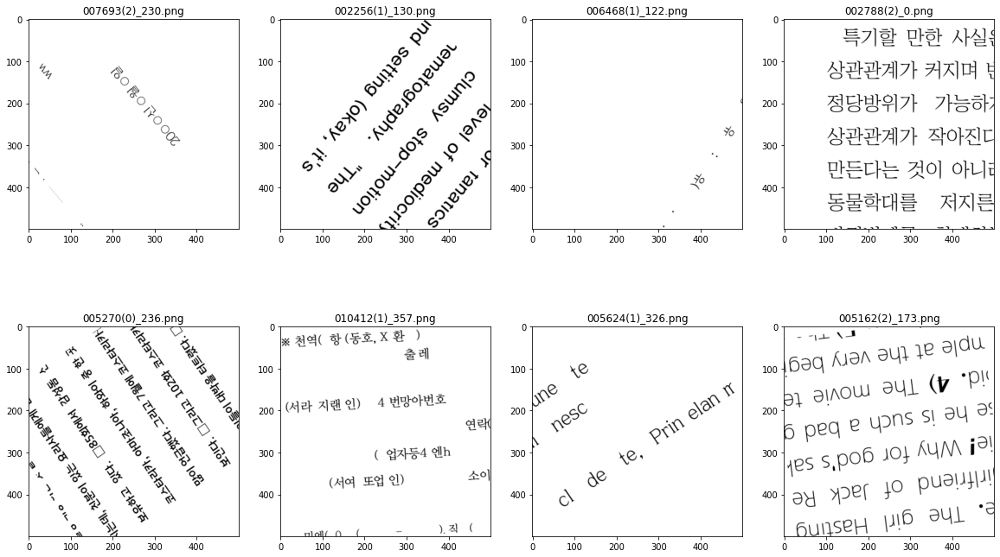

In [20]:

## 랜덤하게 8장 사진을 확인
tmp_imgs = df_train['img_file'].sample(n=8, random_state=42)
plt.figure(figsize=(20, 12))

for num, f_name in enumerate(tmp_imgs):
    img = PIL.Image.open(os.path.join(TRAIN_IMG_PATH, f_name))
    plt.subplot(2, 4, num + 1)
    plt.title(f_name)
    plt.imshow(img)
    plt.axis('on')

---

## 이미지 resize 하기

In [ ]:
## test 이미지 resize

def crop_resize_boxing_img_test(img_name, margin=16, size=img_size) :
    PATH = TEST_IMG_PATH
    data = df_test
        
    img = PIL.Image.open(os.path.join(PATH, img_name))
    
    # pos = data.loc[data["img_file"] == img_name, \
    #                ['bbox_x1','bbox_y1', 'bbox_x2', 'bbox_y2']].values.reshape(-1)

    pos = data.loc[data["img_file"] == img_name, \
                   ['bbox_x1','bbox_y1', 'bbox_x2', 'bbox_y2']].values.reshape(-1)

    width, height = img.size
    x1 = max(0, pos[0] - margin)
    y1 = max(0, pos[1] - margin)
    x2 = min(pos[2] + margin, width)
    y2 = min(pos[3] + margin, height)

    return img.crop((x1,y1,x2,y2)).resize(size)

In [56]:
## train / test 이미지 resize

def crop_resize_boxing_img(PATH, data, img_name, margin=16, size=(224, 224)) :
        
    img = PIL.Image.open(os.path.join(PATH, img_name))   
    pos = data.loc[data["img_file"] == img_name, \
                ['bbox_x1','bbox_y1', 'bbox_x2', 'bbox_y2']].values.reshape(-1)

    width, height = img.size
    x1 = max(0, pos[0] - margin)
    y1 = max(0, pos[1] - margin)
    x2 = min(pos[2] + margin, width)
    y2 = min(pos[3] + margin, height)

    return img.crop((x1,y1,x2,y2)).resize(size)

In [51]:
os.path.join(DATA_PATH, row['img_file'])

'D:/coding/data_set/lomin/train_copy4\\000001(0)_182.png'

In [ ]:
%%time
## train 폴더를 만들고 박스에 맞춰 이미지 resize (train data) 후 폴더에 저장

os.makedirs(os.path.join(DATA_PATH,'train_crop'))

for i, row in df_train.iterrows():
    cropped = crop_resize_boxing_img(TRAIN_IMG_PATH, df_train, row['img_file'])
    cropped.save(f"{os.path.join(DATA_PATH, 'train_crop')}/{row['img_file']}")

In [58]:
%%time
## 폴더를 만들고 박스에 맞춰 이미지 resize (test data) 후 폴더에 저장

os.makedirs(os.path.join(DATA_PATH, 'test_crop'))

for i, row in df_test.iterrows():
    cropped = crop_resize_boxing_img(TEST_IMG_PATH, df_test, row['img_file'])
    cropped.save(f"{os.path.join(DATA_PATH,'test_crop')}/{row['img_file']}")

Wall time: 41.6 s


In [59]:
## crop 이미지 경로 설정

TRAIN_CROP_PATH = os.path.join(DATA_PATH, 'train_crop')
TEST_CROP_PATH = os.path.join(DATA_PATH, 'test_crop')

## 모델링

In [62]:
## train, val, test set 나눠주기

from sklearn.model_selection import train_test_split

## class 를 string 으로 바꿔주고 좌표들을 지워준다.
df_train["class"] = df_train["class"].astype('str')

df_train = df_train[['img_file', 'class']]
df_test = df_test[['img_file']]

its = np.arange(df_train.shape[0])
train_idx, val_idx = train_test_split(its, train_size = 0.7, random_state=42)

X_train = df_train.iloc[train_idx, :]
X_val = df_train.iloc[val_idx, :]

print(X_train.shape)
print(X_val.shape)
print(df_test.shape)

(22680, 2)
(9720, 2)
(3240, 1)


In [69]:
# train / val 데이터 class 숫자 확인
print('train : ', len(X_train['class'].unique()))
print('val : ', len(X_val['class'].unique()))


train :  360
val :  360


In [70]:
import tensorflow as tf
from tensorflow.keras.applications.mobilenet import preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [71]:
## 데이터 제네레이터 구성하기

## 파라미터 설정
## https://keras.io/api/preprocessing/image/

nb_train_samples = len(X_train)
nb_validation_samples = len(X_val)
nb_test_samples = len(df_test)
batch_size = 32

In [72]:
## 입력이미지의 데이터 증강 (Data Augmentation)
train_datagen = ImageDataGenerator(
    width_shift_range=0.2,
    height_shift_range=0.2,
    brightness_range=[0.2,1.0],
    zoom_range=[0.5,0.1],
    preprocessing_function=preprocess_input
)

# val_datagen = ImageDataGenerator(rescale=1. / 255)
# train_datagen = ImageDataGenerator(rescale=1. / 255)

val_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

In [73]:
## 제네레이터 설정
##.flow_from_dataframe
##.flow_from_directory

# Make Generator
train_generator = train_datagen.flow_from_dataframe(
    dataframe=X_train, 
    directory=TRAIN_CROP_PATH,
    x_col = 'img_file',
    y_col = 'class',
    target_size = img_size,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=batch_size,
    seed=42
)

validation_generator = val_datagen.flow_from_dataframe(
    dataframe=X_val, 
    directory=TRAIN_CROP_PATH,
    x_col='img_file',
    y_col='class',
    target_size=img_size,
    color_mode='rgb',
    class_mode='categorical',
    batch_size=batch_size,
    shuffle=False
)

test_generator = test_datagen.flow_from_dataframe(
    dataframe=df_test,
    directory=TEST_CROP_PATH,
    x_col='img_file',
    y_col=None,
    target_size= img_size,
    color_mode='rgb',
    class_mode=None,
    batch_size=batch_size,
    shuffle=False
)

Found 22680 validated image filenames belonging to 360 classes.
Found 9720 validated image filenames belonging to 360 classes.
Found 3240 validated image filenames.


In [74]:
from tensorflow.keras.applications.mobilenet import MobileNet, preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Dropout, Flatten, Activation, Conv2D, GlobalAveragePooling2D
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint

from tensorflow.keras.applications.resnet import ResNet50
from tensorflow.keras.applications.resnet_v2 import ResNet50V2
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications import EfficientNetB0 

In [75]:
## MobileNet 으로  base model을 만든다.

# weights='imagenet' : 이미지 넷에 트레이닝 된 모델을 불러옴

IMG_SHAPE = img_size + (3, )

BaseModel = MobileNet(weights='imagenet', include_top=False, input_shape=IMG_SHAPE)

# BaseModel = EfficientNetB0(weights='imagenet', include_top=False, input_shape=IMG_SHAPE, drop_connect_rate=0.4)

# BaseModel = VGG16(weights='imagenet', include_top=False, input_shape=IMG_SHAPE)

# BaseModel = ResNet50(weights='imagenet', include_top=False, input_shape=IMG_SHAPE)

# BaseModel = ResNet50V2(weights='imagenet', include_top=False, input_shape=IMG_SHAPE)

model = Sequential()
model.add(BaseModel)
model.add(GlobalAveragePooling2D())
model.add(Dense(360, activation='softmax', kernel_initializer='he_normal'))
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenet_1.00_224 (Function (None, 7, 7, 1024)        3228864   
_________________________________________________________________
global_average_pooling2d (Gl (None, 1024)              0         
_________________________________________________________________
dense (Dense)                (None, 360)               369000    
Total params: 3,597,864
Trainable params: 3,575,976
Non-trainable params: 21,888
_________________________________________________________________


In [76]:
## 모델 컴파일 하기
from sklearn.metrics import f1_score

def micro_f1(y_true, y_pred):
    return f1_score(y_true, y_pred, average='micro')

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['acc'])

In [77]:
def get_steps(num_samples, batch_size):
    if (num_samples % batch_size) > 0 :
        return (num_samples // batch_size) + 1
    else :
        return num_samples // batch_size

In [79]:
## 체크포인트 설정

## monitor : val_acc 를 기준으로 저장한다.
## verbose : 1 일 경우 모델이 저장 됨을 표시

from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

filepath = "my_mobilenet_model_{val_acc:.2f}_{val_loss:.4f}.h5"

checkpoint = ModelCheckpoint(filepath, monitor='val_acc', verbose=1, save_best_only=True)
#es = EarlyStopping(monitor='val_acc', min_delta=0, patience=3, verbose=1, mode='auto')

callbackList = [checkpoint]

In [80]:
%%time

history = model.fit_generator(
    train_generator,
    steps_per_epoch = get_steps(nb_train_samples, batch_size),
    epochs=150,
    validation_data = validation_generator,
    validation_steps = get_steps(nb_validation_samples, batch_size),
    callbacks = callbackList
)
gc.collect()

Instructions for updating:
Please use Model.fit, which supports generators.
Epoch 1/150
709/709 [==============================] - ETA: 0s - loss: 4.9109 - acc: 0.0254
Epoch 00001: val_acc improved from -inf to 0.03457, saving model to my_mobilenet_model_0.03_4.2058.h5
709/709 [==============================] - 343s 484ms/step - loss: 4.9109 - acc: 0.0254 - val_loss: 4.2058 - val_acc: 0.0346
Epoch 2/150
709/709 [==============================] - ETA: 0s - loss: 4.2032 - acc: 0.0377
Epoch 00002: val_acc improved from 0.03457 to 0.04897, saving model to my_mobilenet_model_0.05_3.9270.h5
709/709 [==============================] - 239s 338ms/step - loss: 4.2032 - acc: 0.0377 - val_loss: 3.9270 - val_acc: 0.0490
Epoch 3/150
709/709 [==============================] - ETA: 0s - loss: 4.0018 - acc: 0.0507
Epoch 00003: val_acc did not improve from 0.04897
709/709 [==============================] - 239s 337ms/step - loss: 4.0018 - acc: 0.0507 - val_loss: 3.8721 - val_acc: 0.0475
Epoch 4/150
709/

26

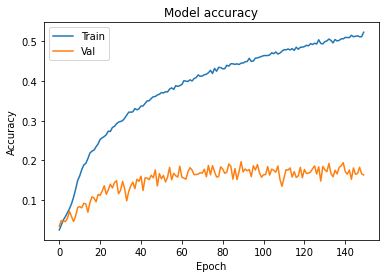

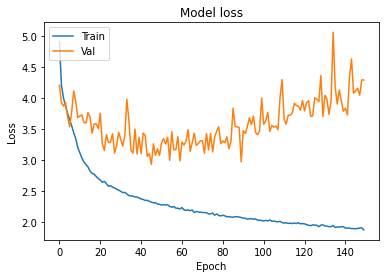

In [81]:
## 트레이닝 결과 곡선

## validation acc 곡선 그래프
# Plot training & validation accuracy values
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Val'], loc='upper left')
plt.show()

## validation loss 곡선 그래프
# Plot training & validation loss values
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Val'], loc='upper left')
plt.show()

In [82]:
## 저장된 모델 리스트 정렬

model_list = sorted([i for i in os.listdir() if "my_" in i])
model_list

['my_mobilenet_model_0.03_4.2058.h5',
 'my_mobilenet_model_0.05_3.7026.h5',
 'my_mobilenet_model_0.05_3.9270.h5',
 'my_mobilenet_model_0.07_3.5402.h5',
 'my_mobilenet_model_0.08_3.6882.h5',
 'my_mobilenet_model_0.08_3.7122.h5',
 'my_mobilenet_model_0.09_3.6081.h5',
 'my_mobilenet_model_0.09_3.6980.h5',
 'my_mobilenet_model_0.11_3.4361.h5',
 'my_mobilenet_model_0.11_3.5086.h5',
 'my_mobilenet_model_0.12_3.2655.h5',
 'my_mobilenet_model_0.14_3.1144.h5',
 'my_mobilenet_model_0.14_3.1573.h5',
 'my_mobilenet_model_0.14_3.2902.h5',
 'my_mobilenet_model_0.15_3.1007.h5',
 'my_mobilenet_model_0.15_3.2360.h5',
 'my_mobilenet_model_0.16_2.9332.h5',
 'my_mobilenet_model_0.16_3.1082.h5',
 'my_mobilenet_model_0.18_3.0001.h5',
 'my_mobilenet_model_0.18_3.0792.h5',
 'my_mobilenet_model_0.19_2.9922.h5',
 'my_mobilenet_model_0.19_3.1659.h5',
 'my_mobilenet_model_0.19_3.1872.h5',
 'my_mobilenet_model_0.20_2.9747.h5']

In [83]:
## BEST Model 선택

model.load_weights(model_list[-1])

---
---
---



## 추가 파일 확인

In [89]:
N_TEST = os.path.join(DATA_PATH, 'test_dj')

In [86]:
n_test = pd.DataFrame(columns=['img_file', 'bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2'])
re_test = pd.DataFrame(columns=['img_file', 'class'])

In [121]:
n_test

,img_file,bbox_x1,bbox_y1,bbox_x2,bbox_y2
0,00000007.jpg,0,0,3492,4656
1,000001.png,0,0,1751,2334
2,00000315.jpg,0,0,3492,4656
3,00000329.jpg,0,0,3492,4656
4,000006.png,0,0,1104,2334
...,...,...,...,...,...
95,03_20210519_073208.jpg,0,0,4032,3024
96,fix00000661.jpg,0,0,3024,4032
97,fix00000725.jpg,0,0,3024,4032
98,fix00000761.jpg,0,0,3024,4032


In [90]:
from PIL import Image

for i in os.listdir(N_TEST):
    img_open = Image.open(N_TEST + '/'+ i)
    img_array = np.asarray(img_open)
    file_name = i
    x_min = 0
    y_min = 0
    x_max = img_array.shape[1]
    y_max = img_array.shape[0]
    n_test = n_test.append(pd.DataFrame([[file_name, x_min, y_min, x_max, y_max]], 
                        columns=['img_file', 'bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2']),
                        ignore_index=True)
    re_test = re_test.append(pd.DataFrame([[file_name]], 
                        columns=['img_file']),
                        ignore_index=True)

In [93]:
n_test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
nb_n_test_samples = len(os.listdir(N_TEST))

In [95]:
n_test_generator = n_test_datagen.flow_from_dataframe(
    dataframe=n_test,
    directory=N_TEST,
    x_col='img_file',
    y_col=None,
    target_size= img_size,
    color_mode='rgb',
    class_mode=None,
    batch_size=batch_size,
    shuffle=False
)

Found 100 validated image filenames.


In [96]:
%%time
## Best Model 적용

n_test_generator.reset()
prediction = model.predict_generator(
    generator = n_test_generator,
    steps = get_steps(nb_n_test_samples, batch_size),
    verbose=1
)

4/4 [==============================] - 4s 1s/step
Wall time: 8.19 s


## 추가 결과표 작성

In [97]:
## 결과를 표로 작성

predicted_class_indices=np.argmax(prediction, axis=1)

# Generator class dictionary mapping
labels = (train_generator.class_indices)
labels = dict((v,k) for k,v in labels.items())
predictions = [labels[k] for k in predicted_class_indices]

for i in range(len(os.listdir(N_TEST))) :
    re_test['class'][i] = predictions[i]

re_test

,img_file,class
0,00000007.jpg,90
1,000001.png,2
2,00000315.jpg,297
3,00000329.jpg,255
4,000006.png,180
...,...,...
95,03_20210519_073208.jpg,343
96,fix00000661.jpg,293
97,fix00000725.jpg,42
98,fix00000761.jpg,110


In [118]:
import cv2
import matplotlib.pyplot as plt

def model_result(k):
    ro_angle = int(re_test['class'][k])
    f_name = os.listdir(N_TEST)[k]

    plt.figure(figsize=(15,8))

    img_rgb = cv2.imread(os.path.join(N_TEST, f_name))
    img_rgb = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2RGB)
    h, w, c = img_rgb.shape

    ro_center = int(w/2), int(h/2) # 정수
    new_h, new_w = h, w

    img_ro = cv2.getRotationMatrix2D(ro_center, ro_angle, 1) # 1은 확대/축소값
    re_ro = cv2.warpAffine(img_rgb, img_ro, (new_h, new_w))

    # 출력
    plt.subplot(1, 2, 1) # 1행 2열에서 1번째 열
    plt.title("Original Image - {}".format(f_name))
    plt.imshow(img_rgb)

    plt.subplot(1, 2, 2) # 1행 2열에서 2번째 열
    plt.title("Result Image - rotation {}".format(ro_angle))
    plt.imshow(re_ro)

    plt.show()


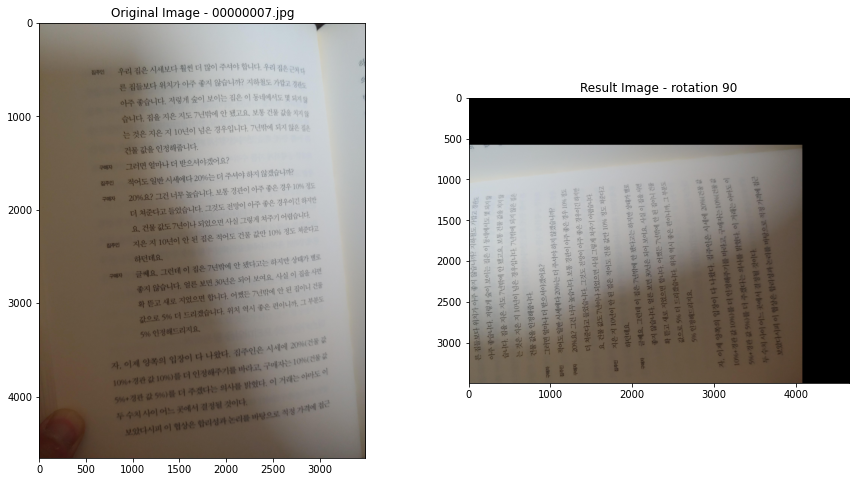

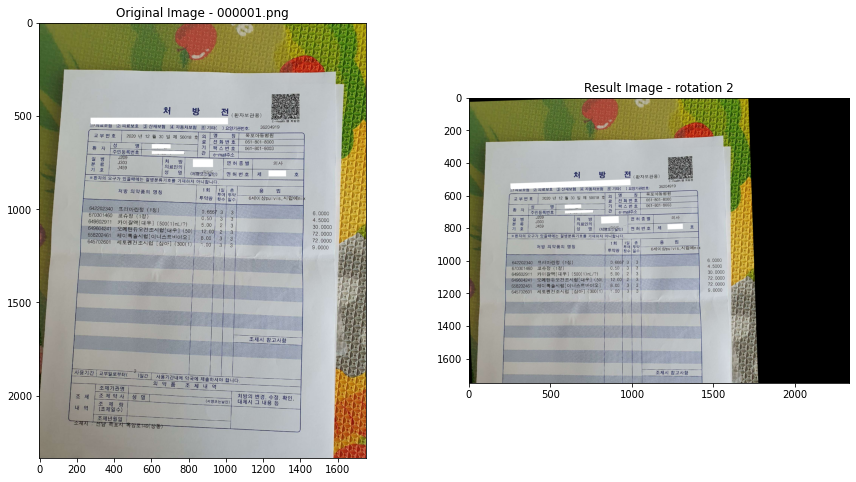

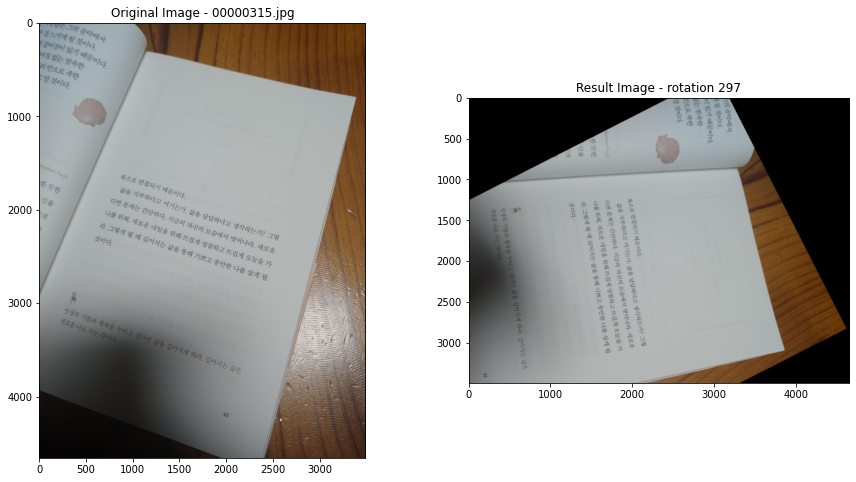

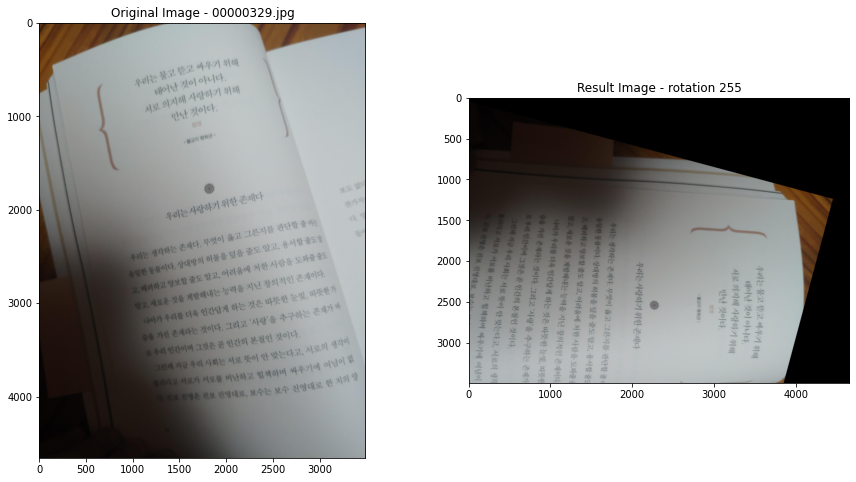

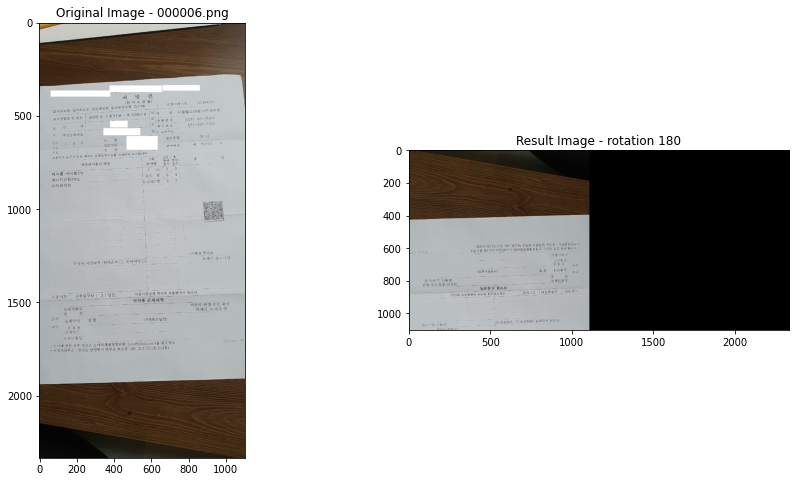

...

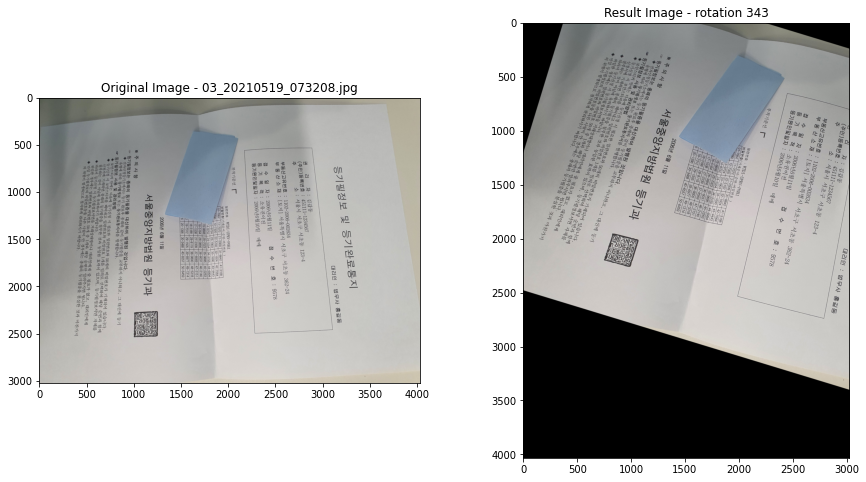

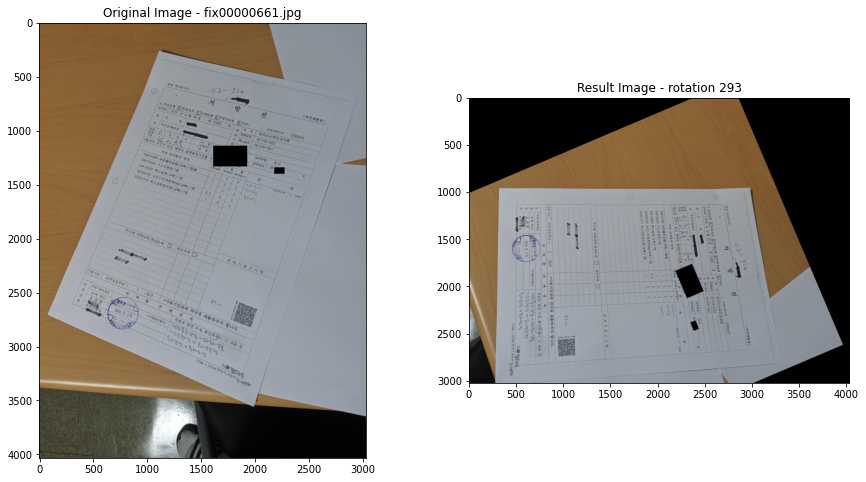

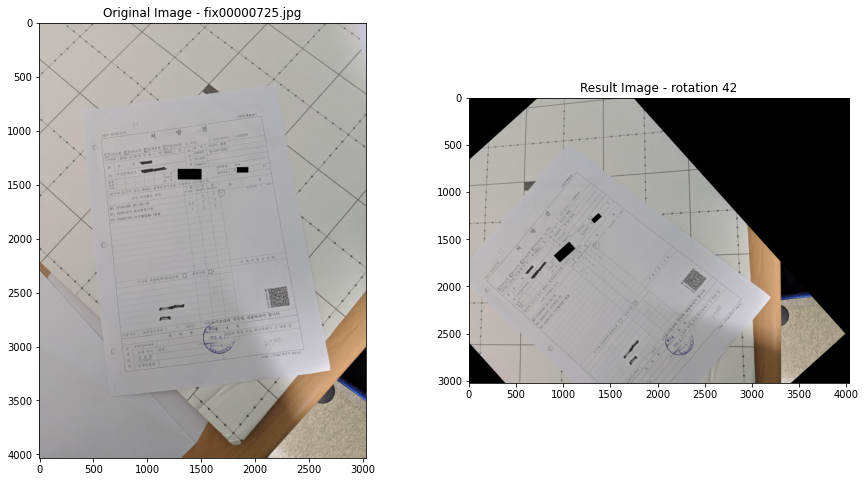

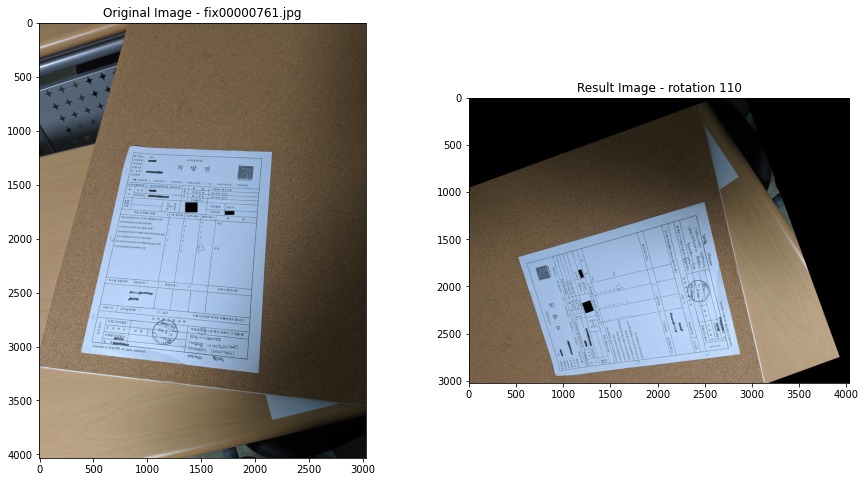

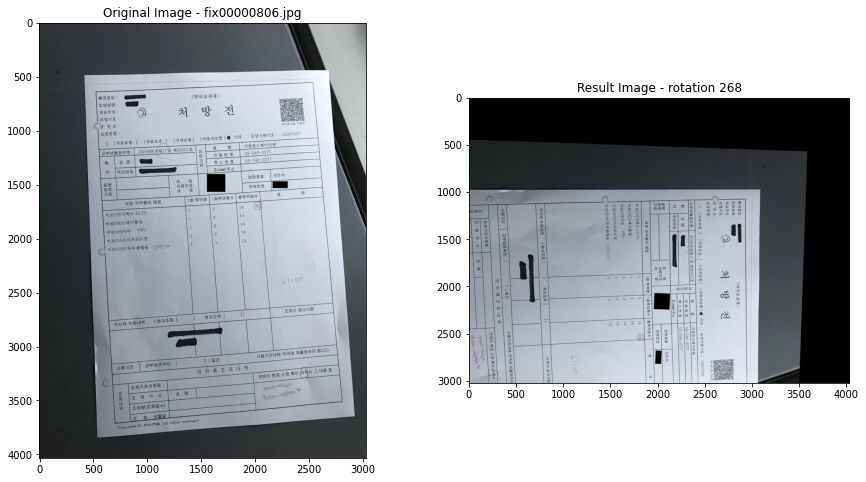

In [120]:
for i in range(0,100):
    model_result(i)

---
---
---

In [182]:
import os
import glob
import cv2
import random
import numpy as np

def last_img(input_path, output_path):
    # 폴더 만들기
    try :
        os.makedirs(output_path)
    except:
        pass

    img_list = sorted(glob.glob(input_path + '/*'))

    # # 각도
    # for j in range(0, 1):
    #     # 전체 이미지 중 랜덤하게 추출 == img_count
    #     random_list = np.random.choice(img_list, img_count, replace=False)
        
    #     for i in random_list:
    for i in img_list:
        src = cv2.imread(i, cv2.IMREAD_COLOR)
        
        height, width, channel = src.shape
        
        ## 이미지 에서 500*500 이미지를 crop 함
        x_range = width - 1001
        y_range = height - 1001
        
        # 한장의 이미지에서 몇번 crop 할 것 인가?
        for k in range(0, 5):
            x1 = x_random = random.randint(0, x_range)
            y1 = y_random = random.randint(0, y_range)
            x2 = x1 + 1000
            y2 = y1 + 1000 
            # print(y1, y2, x1, x2)
            
            dst = src[y1:y2, x1:x2]


            total_path = output_path + i.split('\\')[-1].split('.')[0] + '('+str(k)+")_" + str(0) + '.png' 
            cv2.imwrite(total_path, dst)
            
            # 이미지 회전
            rotation_crop(0, total_path)
            


In [183]:
# 테스트 이미지 5 군데 씩 copr (1000 x 1000)

## result
input_path = os.path.join(DATA_PATH, 'test_dj/')
output_path = os.path.join(DATA_PATH, 'test_copr_dj/')

## 전체 중 랜덤 추출 * 360 * 한장에 몇번 corp => 3 * 360 * 3 = 3240
last_img(input_path, output_path)

## 테스트 이미지 copr 추가 파일 확인

In [268]:
N_TEST = os.path.join(DATA_PATH, 'test_dj')
L_TEST = os.path.join(DATA_PATH, 'test_copr_dj')

In [269]:
l_test = pd.DataFrame(columns=['img_file', 'bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2'])
le_test = pd.DataFrame(columns=['img_file', 'class'])

In [270]:
l_test

,img_file,bbox_x1,bbox_y1,bbox_x2,bbox_y2


In [271]:
from PIL import Image

for i in os.listdir(L_TEST):
    img_open = Image.open(L_TEST + '/'+ i)
    img_array = np.asarray(img_open)
    file_name = i
    x_min = 0
    y_min = 0
    x_max = img_array.shape[1]
    y_max = img_array.shape[0]
    l_test = l_test.append(pd.DataFrame([[file_name, x_min, y_min, x_max, y_max]], 
                        columns=['img_file', 'bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2']),
                        ignore_index=True)
    le_test = le_test.append(pd.DataFrame([[file_name]], 
                        columns=['img_file']),
                        ignore_index=True)

In [272]:
l_n_test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
l_nb_n_test_samples = len(os.listdir(L_TEST))

In [273]:
l_n_test_generator = n_test_datagen.flow_from_dataframe(
    dataframe=l_test,
    directory=L_TEST,
    x_col='img_file',
    y_col=None,
    target_size= img_size,
    color_mode='rgb',
    class_mode=None,
    batch_size=batch_size,
    shuffle=False
)

Found 1000 validated image filenames.


In [274]:
%%time
## Best Model 적용

l_n_test_generator.reset()
prediction = model.predict_generator(
    generator = l_n_test_generator,
    steps = get_steps(l_nb_n_test_samples, batch_size),
    verbose=1
)

32/32 [==============================] - 17s 531ms/step
Wall time: 18.2 s


## 추가 결과표 작성

In [275]:
## 결과를 표로 작성

predicted_class_indices=np.argmax(prediction, axis=1)

# Generator class dictionary mapping
labels = (train_generator.class_indices)
labels = dict((v,k) for k,v in labels.items())
predictions = [labels[k] for k in predicted_class_indices]

for i in range(len(os.listdir(L_TEST))) :
    le_test['class'][i] = predictions[i]

le_test

,img_file,class
0,00000007(0)_0.png,357
1,00000007(1)_0.png,357
2,00000007(2)_0.png,2
3,00000007(3)_0.png,357
4,00000007(4)_0.png,357
...,...,...
995,fix00000806(5)_0.png,357
996,fix00000806(6)_0.png,178
997,fix00000806(7)_0.png,357
998,fix00000806(8)_0.png,355


In [276]:
re_test1 = pd.DataFrame.copy(re_test)
re_test1

,img_file,class
0,00000007.jpg,90
1,000001.png,2
2,00000315.jpg,297
3,00000329.jpg,255
4,000006.png,180
...,...,...
95,03_20210519_073208.jpg,343
96,fix00000661.jpg,293
97,fix00000725.jpg,42
98,fix00000761.jpg,110


In [277]:
df111 = pd.DataFrame(columns=['class1', 'class2', 'class3', 'class4' , 'class5', 'class6', 'class7', 'class8', 'class9', 'class10'])

In [278]:
df111

,class1,class2,class3,class4,class5,class6,class7,class8,class9,class10


In [282]:
for i in range(0,500):
    find_num = int(le_test['img_file'][i].split('(')[-1].split(')')[0])
    
    if find_num == 0:
        k1 = le_test['class'][i]
        
    elif find_num == 1:
        k2 = le_test['class'][i]
        
    elif find_num == 2:
        k3 = le_test['class'][i]
        
    elif find_num == 3:
        k4 = le_test['class'][i]
        
    elif find_num == 4:
        k5 = le_test['class'][i]
        
    elif find_num == 5:
        k6 = le_test['class'][i]
        
    elif find_num == 6:
        k7 = le_test['class'][i]
        
    elif find_num == 7:
        k8 = le_test['class'][i]
        
    elif find_num == 8:
        k9 = le_test['class'][i]
        
    elif find_num == 9:
        k10 = le_test['class'][i]
        
    df111 = df111.append(pd.DataFrame([[k1, k2, k3, k4, k5, k6, k7, k8, k9, k10]], columns=['class1', 'class2', 'class3', 'class4' , 'class5', 'class6', 'class7', 'class8', 'class9', 'class10']),ignore_index=True)

In [283]:
 df111 

,class1,class2,class3,class4,class5,class6,class7,class8,class9,class10
0,357,3,184,184,90,3,90,184,184,3
1,357,357,184,184,90,3,90,184,184,3
2,357,357,2,184,90,3,90,184,184,3
3,357,357,2,357,90,3,90,184,184,3
4,357,357,2,357,357,3,90,184,184,3
...,...,...,...,...,...,...,...,...,...,...
495,343,3,184,184,90,3,2,3,2,184
496,343,3,184,184,90,3,90,3,2,184
497,343,3,184,184,90,3,90,184,2,184
498,343,3,184,184,90,3,90,184,184,184


In [312]:
from collections import Counter


list_angle = []
for i in range(1,11):
    dand = df111['class{}'.format(i)][0]
    angle = df111['class{}'.format(i)][0]
    if int(angle) > 90:
        angle = 360 - int(angle)
    else:
        int(angle)
    list_angle.append(int(angle))
    # print(dand, '\t', angle)
print(list_angle)
print(Counter(list_angle).most_common())
print('최빈 값 : ', Counter(list_angle).most_common(1)[0][0])

[3, 3, 176, 176, 90, 3, 90, 176, 176, 3]
[(3, 4), (176, 4), (90, 2)]
최빈 값 :  3


In [349]:
df111.head(50)

,class1,class2,class3,class4,class5,class6,class7,class8,class9,class10
0,357,3,184,184,90,3,90,184,184,3
1,357,357,184,184,90,3,90,184,184,3
2,357,357,2,184,90,3,90,184,184,3
3,357,357,2,357,90,3,90,184,184,3
4,357,357,2,357,357,3,90,184,184,3
5,357,357,2,357,357,355,90,184,184,3
6,357,357,2,357,357,355,357,184,184,3
7,357,357,2,357,357,355,357,357,184,3
8,357,357,2,357,357,355,357,357,174,3
9,357,357,2,357,357,355,357,357,174,357


In [342]:
# 개의 각도중 최빈값 찾기

from collections import Counter

def most_angle(j):
    list_angle = []
    for i in range(1, 11):
        dand = df111['class{}'.format(i)][j]
        angle = df111['class{}'.format(i)][j]
        if int(angle) > 180:
            angle = 360 - int(angle)
        else:
            int(angle)
        list_angle.append(int(angle))
        # print(dand, '\t', angle)
    print(list_angle)
    print(Counter(list_angle).most_common())
    print(Counter(list_angle).most_common(1)[0][0])
    print()
    most_li.append(Counter(list_angle).most_common(1)[0][0])

In [347]:
df111['class1'][11]

'90'

In [343]:
most_li = []

In [346]:
most_li = []
for i in range(1,101):
    most_angle(2)
most_li

[3, 3, 2, 176, 90, 3, 90, 176, 176, 3]
[(3, 4), (176, 3), (90, 2), (2, 1)]
3

[3, 3, 2, 176, 90, 3, 90, 176, 176, 3]
[(3, 4), (176, 3), (90, 2), (2, 1)]
3

[3, 3, 2, 176, 90, 3, 90, 176, 176, 3]
[(3, 4), (176, 3), (90, 2), (2, 1)]
3

[3, 3, 2, 176, 90, 3, 90, 176, 176, 3]
[(3, 4), (176, 3), (90, 2), (2, 1)]
3

[3, 3, 2, 176, 90, 3, 90, 176, 176, 3]
[(3, 4), (176, 3), (90, 2), (2, 1)]
3

[3, 3, 2, 176, 90, 3, 90, 176, 176, 3]
[(3, 4), (176, 3), (90, 2), (2, 1)]
3

[3, 3, 2, 176, 90, 3, 90, 176, 176, 3]
[(3, 4), (176, 3), (90, 2), (2, 1)]
3

[3, 3, 2, 176, 90, 3, 90, 176, 176, 3]
[(3, 4), (176, 3), (90, 2), (2, 1)]
3

[3, 3, 2, 176, 90, 3, 90, 176, 176, 3]
[(3, 4), (176, 3), (90, 2), (2, 1)]
3

[3, 3, 2, 176, 90, 3, 90, 176, 176, 3]
[(3, 4), (176, 3), (90, 2), (2, 1)]
3

[3, 3, 2, 176, 90, 3, 90, 176, 176, 3]
[(3, 4), (176, 3), (90, 2), (2, 1)]
3

[3, 3, 2, 176, 90, 3, 90, 176, 176, 3]
[(3, 4), (176, 3), (90, 2), (2, 1)]
3

[3, 3, 2, 176, 90, 3, 90, 176, 176, 3]
[(3, 4), (176, 3), (90, 2

[3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3]